# Initialization

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import torch as T
import pickle
import os

In [3]:
import DDQN
import TD3
import training
import testing
import plot

In [4]:
if T.cuda.is_available():
    device = T.device('cuda:0')
    device_type = 'gpu'
    print('Using GPU')
    
else:
    device = T.device('cpu')
    device_type = 'cpu'
    print('Using CPU')

Using GPU


In [5]:
def save_object(obj, filename):
    with open(filename + '.pkl', 'wb') as file:
        pickle.dump(obj, file, pickle.HIGHEST_PROTOCOL)
        
def load_object(filename):
    if not os.path.isfile(filename + '.pkl'):
        loaded_obj = []
        
    else:
        with open(filename + '.pkl', 'rb') as file:
            loaded_obj = pickle.load(file)
            
    print(f'Size of loaded {filename}: {len(loaded_obj)}')    
    return loaded_obj

# Training

In [6]:
agents_DDQN = load_object('agents_DDQN_' + device_type)
agents_TD3 = load_object('agents_TD3_' + device_type)

Size of loaded agents_DDQN_gpu: 3
Size of loaded agents_TD3_gpu: 3


In [7]:
max_steps=4e5

### DDQN

In [8]:
%%time
agents_DDQN += training.train_agents(agent=DDQN.Agent(device=device), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_DDQN, 'agents_DDQN_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -12.58362576792751
CPU times: total: 8h 42min 51s
Wall time: 8h 44min 45s


In [8]:
%%time
agents_DDQN += training.train_agents(agent=DDQN.Agent(device=device), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_DDQN, 'agents_DDQN_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -12.529052917015484
CPU times: total: 9h 15min 17s
Wall time: 9h 16min 38s


In [9]:
%%time
agents_DDQN += training.train_agents(agent=DDQN.Agent(device=device), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_DDQN, 'agents_DDQN_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -14.034758223531613
CPU times: total: 8h 37min 48s
Wall time: 8h 38min 52s


### TD3

In [9]:
%%time
agents_TD3 += training.train_agents(agent=TD3.Agent(device=device, buffer_size=max_steps), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_TD3, 'agents_TD3_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -11.398119881010215
CPU times: total: 7h 14min 31s
Wall time: 7h 15min 21s


In [31]:
%%time
agents_TD3 += training.train_agents(agent=TD3.Agent(device=device, buffer_size=max_steps), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_TD3, 'agents_TD3_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -12.15316665436897
CPU times: total: 7h 34min 8s
Wall time: 7h 34min 58s


In [32]:
%%time
agents_TD3 += training.train_agents(agent=TD3.Agent(device=device, buffer_size=max_steps), max_steps=max_steps, n_agt=1, get_history=True, find_best_agent=True, eval_interval=5, eval_runs=200)
save_object(agents_TD3, 'agents_TD3_' + device_type)

training with 400000 max_steps
running 200 episodes to evaluate agents every 5 training episodes


best agent score: -10.90196327693122
CPU times: total: 7h 21min 33s
Wall time: 7h 21min 33s


# Plot Training

### DDQN

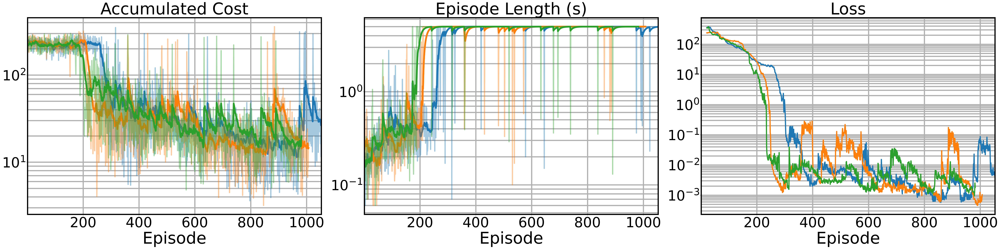

In [7]:
plot.plot_multiple_agents(agents_data=agents_DDQN, show_loss=True, loss_skip=20, size_x=48, size_y=12, save_to_file='output_images/plot_training_ddqn')

### TD3

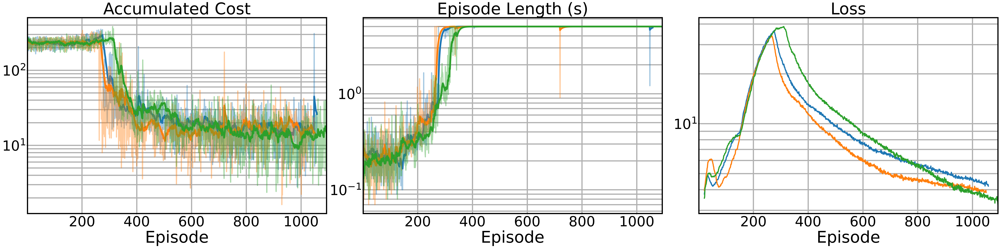

In [8]:
plot.plot_multiple_agents(agents_data=agents_TD3, show_loss=True, loss_skip=20, size_x=48, size_y=12, save_to_file='output_images/plot_training_td3')

### DDQN and TD3

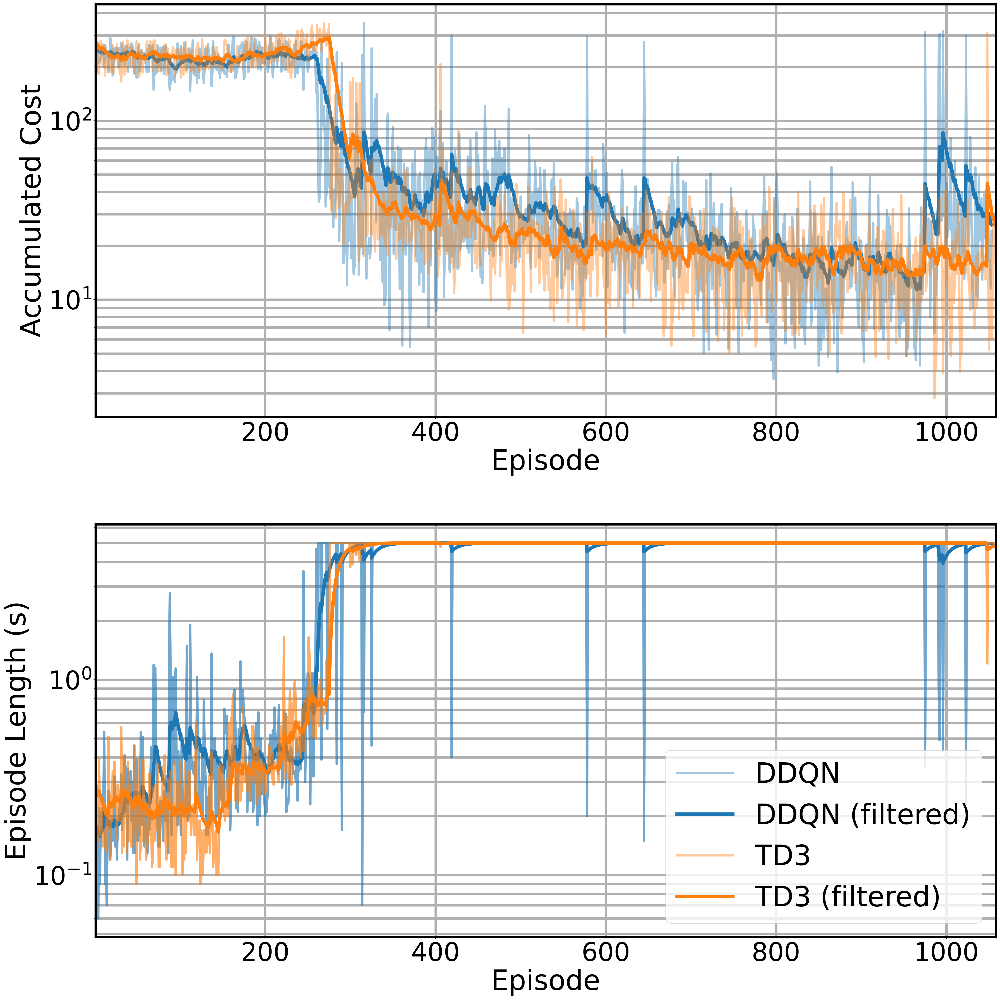

In [9]:
plot.plot_compare_trainings(agent_DDQN=agents_DDQN[0], agent_TD3=agents_TD3[0], transparency=0.4, show_loss=False, size_x=24, size_y=24, save_to_file='output_images/plot_training_compare')

# Evaluation

### DDQN

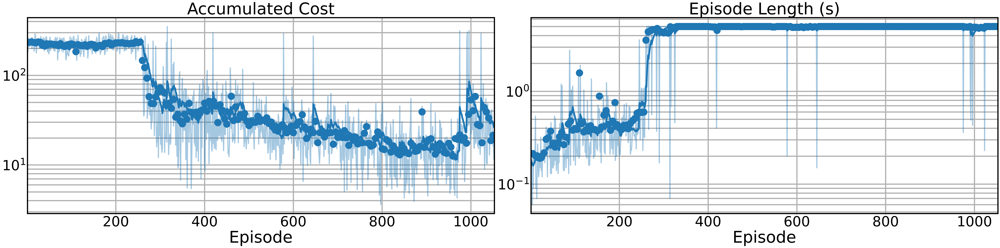

In [10]:
plot.plot_multiple_agents(agents_data=[agents_DDQN[0]], size_x=48, size_y=12, plot_eval=True, save_to_file='output_images/plot_single_evaluation_ddqn')

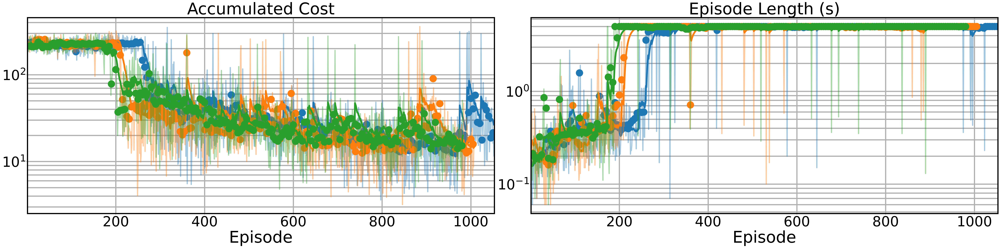

In [11]:
plot.plot_multiple_agents(agents_data=agents_DDQN, size_x=48, size_y=12, plot_eval=True, save_to_file='output_images/plot_multi_evaluation_ddqn')

### TD3

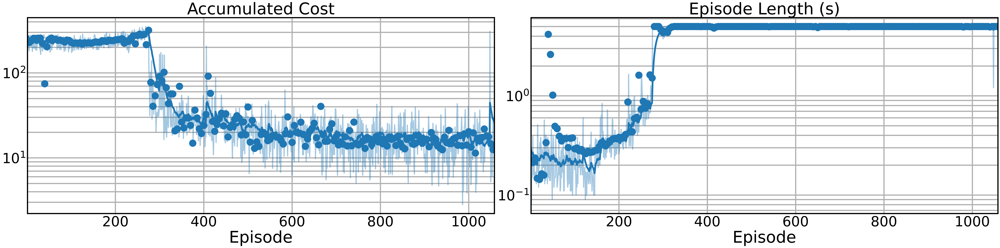

In [12]:
plot.plot_multiple_agents(agents_data=[agents_TD3[0]], size_x=48, size_y=12, plot_eval=True, save_to_file='output_images/plot_single_evaluation_td3')

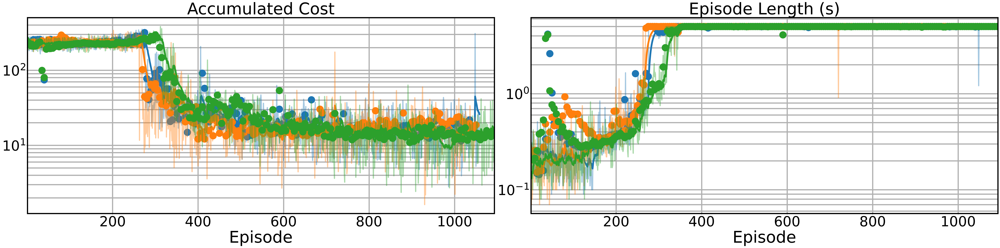

In [13]:
plot.plot_multiple_agents(agents_data=agents_TD3, size_x=48, size_y=12, plot_eval=True, save_to_file='output_images/plot_multi_evaluation_td3')

# Agent Testing

In [14]:
%%time
test_models_DDQN = testing.test_agent(agent=agents_DDQN[0][1], size=30, sim_time=3.0)

IntProgress(value=0, max=299)

IntProgress(value=0, max=29)

CPU times: total: 18.9 s
Wall time: 17.8 s


In [15]:
%%time
test_models_TD3 = testing.test_agent(agent=agents_TD3[0][1], size=30, sim_time=3.0)

IntProgress(value=0, max=299)

IntProgress(value=0, max=29)

CPU times: total: 15.7 s
Wall time: 14.5 s


In [16]:
plot.plot_both_tests(test_models_DDQN, test_models_TD3, save_to_file='output_images/plot_both_tests', y_start_theta=-14, y_end_theta=14, y_start_x=-28, y_end_x=28)

# Action Map

### DDQN

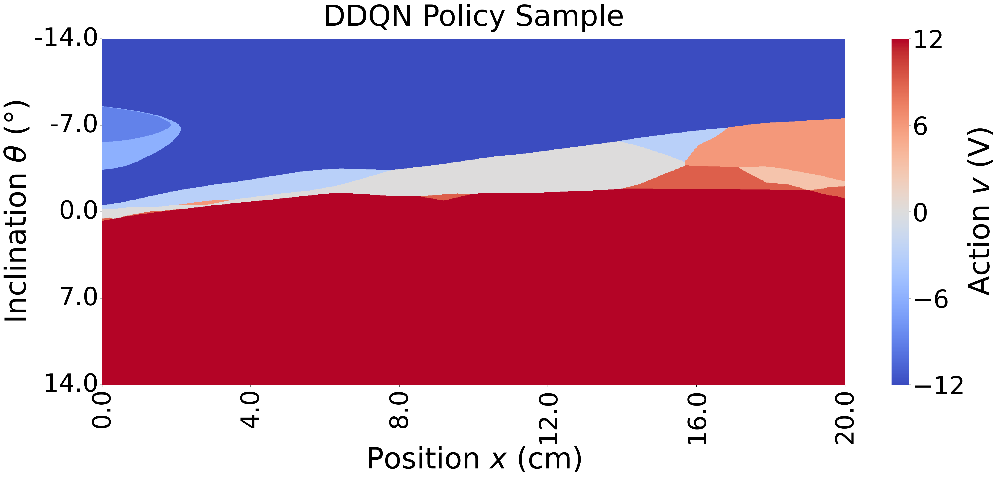

CPU times: total: 12min 28s
Wall time: 12min 30s


In [17]:
%%time
plot.plot_policy_heatmap(agent=agents_DDQN[0][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='DDQN Policy Sample', save_to_file='output_images/plot_actions_ddqn')

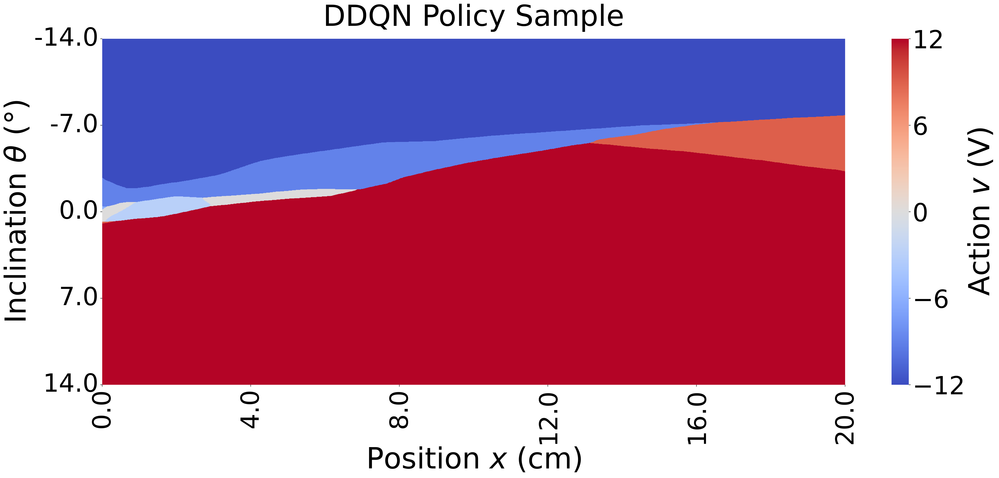

CPU times: total: 12min 9s
Wall time: 12min 10s


In [18]:
%%time
plot.plot_policy_heatmap(agent=agents_DDQN[1][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='DDQN Policy Sample')

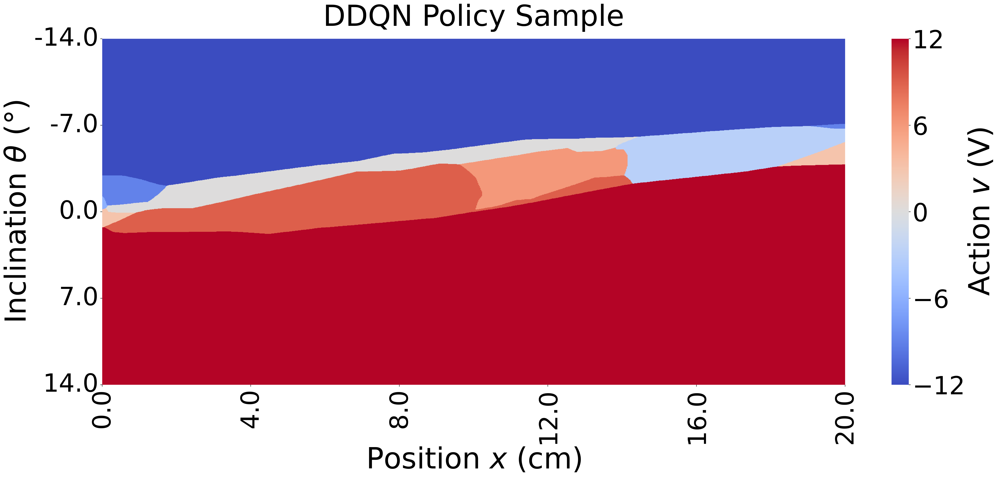

CPU times: total: 12min 15s
Wall time: 12min 20s


In [19]:
%%time
plot.plot_policy_heatmap(agent=agents_DDQN[2][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='DDQN Policy Sample')

### TD3

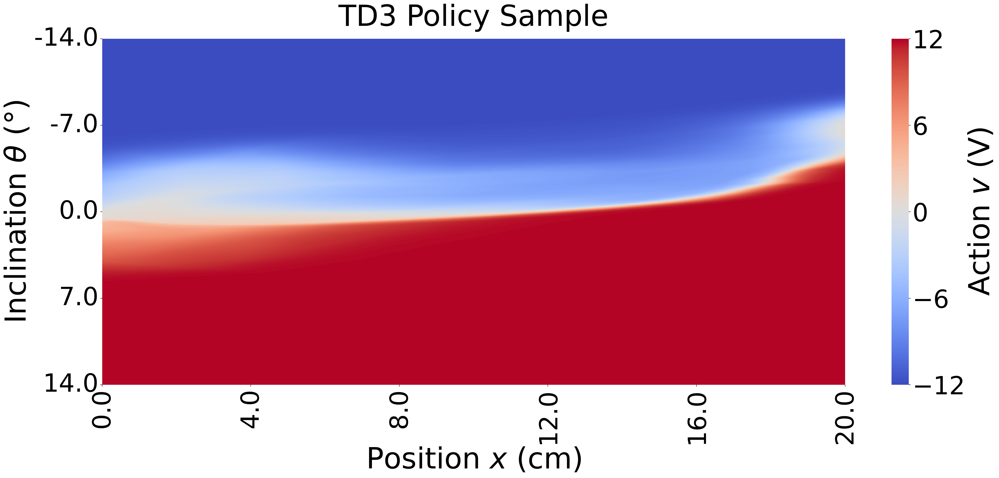

CPU times: total: 12min 10s
Wall time: 12min 25s


In [20]:
%%time
plot.plot_policy_heatmap(agent=agents_TD3[0][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='TD3 Policy Sample', save_to_file='output_images/plot_actions_td3')

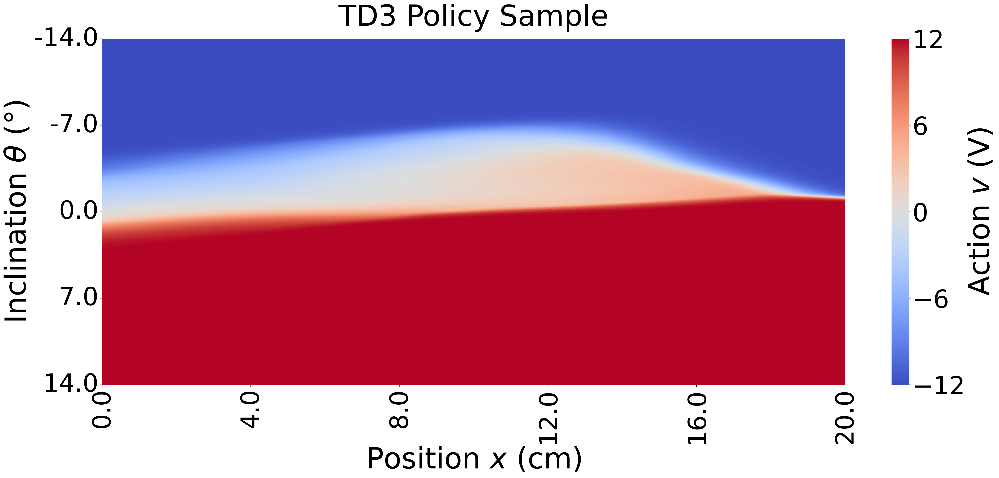

CPU times: total: 12min 58s
Wall time: 13min 27s


In [21]:
%%time
plot.plot_policy_heatmap(agent=agents_TD3[1][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='TD3 Policy Sample')

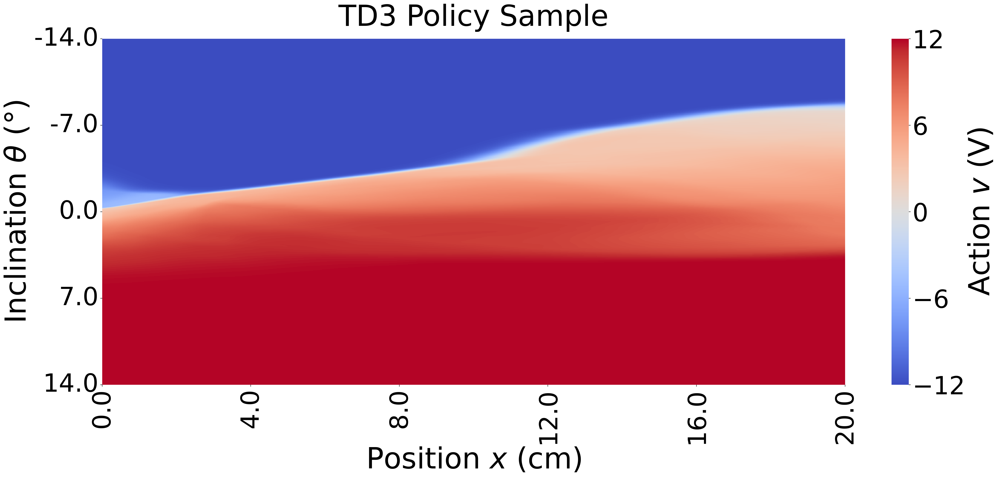

CPU times: total: 12min 40s
Wall time: 13min 2s


In [22]:
%%time
plot.plot_policy_heatmap(agent=agents_TD3[2][1], p_lim=14.0, x_lim=0.2, points=1001, ticks_x=6, ticks_y=5, title='TD3 Policy Sample')

# Control with Input Signal

## Step

In [23]:
%%time
models_with_input_DDQN, input_signal_data_DDQN = testing.test_agent_with_input(agents_data=agents_DDQN, sim_time=6.0, t1=1.0, x1=0.1)
models_with_input_TD3, input_signal_data_TD3 = testing.test_agent_with_input(agents_data=agents_TD3, sim_time=6.0, t1=1.0, x1=0.1)

CPU times: total: 4.25 s
Wall time: 4.24 s


In [24]:
plot.plot_both_models_with_input(models_with_input_DDQN, models_with_input_TD3, input_signal_data_DDQN, input_signal_data_TD3, save_to_file='output_images/plot_step', 
                                 y_start_theta=-2.6, y_end_theta=6.3, y_start_x=-1.8, y_end_x=11)

## Ramp

In [25]:
%%time
models_with_input_DDQN, input_signal_data_DDQN = testing.test_agent_with_input(agents_data=agents_DDQN, sim_time=7.0, t1=1.0, r1=0.02, t2=4.0, input_signal='ramp')
models_with_input_TD3, input_signal_data_TD3 = testing.test_agent_with_input(agents_data=agents_TD3, sim_time=7.0, t1=1.0, r1=0.02, t2=4.0, input_signal='ramp')

CPU times: total: 4.92 s
Wall time: 4.99 s


In [26]:
plot.plot_both_models_with_input(models_with_input_DDQN, models_with_input_TD3, input_signal_data_DDQN, input_signal_data_TD3, save_to_file='output_images/plot_ramp')

## Step with Noise

In [27]:
%%time
models_with_input_DDQN, input_signal_data_DDQN = testing.test_agent_with_input(agents_data=agents_DDQN, sim_time=6.0, t1=1.0, x1=0.1, 
                                                                               noise_std_x=0.01, noise_std_dx=0.01, noise_std_p=1.0, noise_std_dp=0.1, noise_std_v=0.1)
models_with_input_TD3, input_signal_data_TD3 = testing.test_agent_with_input(agents_data=agents_TD3, sim_time=6.0, t1=1.0, x1=0.1, 
                                                                             noise_std_x=0.01, noise_std_dx=0.01, noise_std_p=1.0, noise_std_dp=0.1, noise_std_v=0.1)

CPU times: total: 4.62 s
Wall time: 4.67 s


In [28]:
plot.plot_both_models_with_input(models_with_input_DDQN, models_with_input_TD3, input_signal_data_DDQN, input_signal_data_TD3, save_to_file='output_images/plot_step_noise')

## Ramp with Noise

In [29]:
%%time
models_with_input_DDQN, input_signal_data_DDQN = testing.test_agent_with_input(agents_data=agents_DDQN, sim_time=7.0, t1=1.0, r1=0.02, t2=4.0, input_signal='ramp', 
                                                                               noise_std_x=0.01, noise_std_dx=0.01, noise_std_p=1.0, noise_std_dp=0.1, noise_std_v=0.1)
models_with_input_TD3, input_signal_data_TD3 = testing.test_agent_with_input(agents_data=agents_TD3, sim_time=7.0, t1=1.0, r1=0.02, t2=4.0, input_signal='ramp', 
                                                                             noise_std_x=0.01, noise_std_dx=0.01, noise_std_p=1.0, noise_std_dp=0.1, noise_std_v=0.1)

CPU times: total: 5.41 s
Wall time: 5.41 s


In [30]:
plot.plot_both_models_with_input(models_with_input_DDQN, models_with_input_TD3, input_signal_data_DDQN, input_signal_data_TD3, save_to_file='output_images/plot_ramp_noise')

# Training Histories

In [31]:
histories_DDQN = load_object('histories_DDQN')
histories_TD3 = load_object('histories_TD3')

Size of loaded histories_DDQN: 15
Size of loaded histories_TD3: 15


In [32]:
max_steps=4e5

### DDQN

In [15]:
%%time
agents_DDQN_with_history = training.train_agents(agent=DDQN.Agent(device=device), max_steps=max_steps, n_agt=1, get_history=True)
histories_DDQN += [agent_data[2] for agent_data in agents_DDQN_with_history]
save_object(histories_DDQN, 'histories_DDQN')

training with 400000 max_steps
running 100 episodes to evaluate agents every 30 training episodes


CPU times: total: 2h 52min 11s
Wall time: 2h 52min 53s


In [8]:
%%time
agents_DDQN_with_history = training.train_agents(agent=DDQN.Agent(device=device), max_steps=max_steps, n_agt=5, get_history=True)
histories_DDQN += [agent_data[2] for agent_data in agents_DDQN_with_history]
save_object(histories_DDQN, 'histories_DDQN')

training with 400000 max_steps
running 100 episodes to evaluate agents every 30 training episodes


CPU times: total: 14h 42min 5s
Wall time: 14h 47min 24s


### TD3

In [11]:
%%time
agents_TD3_with_history = training.train_agents(agent=TD3.Agent(device=device, buffer_size=max_steps), max_steps=max_steps, n_agt=1, get_history=True)
histories_TD3 += [agent_data[2] for agent_data in agents_TD3_with_history]
save_object(histories_TD3, 'histories_TD3')

training with 400000 max_steps
running 100 episodes to evaluate agents every 30 training episodes


CPU times: total: 2h 40min 45s
Wall time: 2h 41min 32s


In [9]:
%%time
agents_TD3_with_history = training.train_agents(agent=TD3.Agent(device=device, buffer_size=max_steps), max_steps=max_steps, n_agt=5, get_history=True)
histories_TD3 += [agent_data[2] for agent_data in agents_TD3_with_history]
save_object(histories_TD3, 'histories_TD3')

training with 400000 max_steps
running 100 episodes to evaluate agents every 30 training episodes


CPU times: total: 13h 7min 2s
Wall time: 13h 7min 2s


# Evaluation Mean

### DDQN

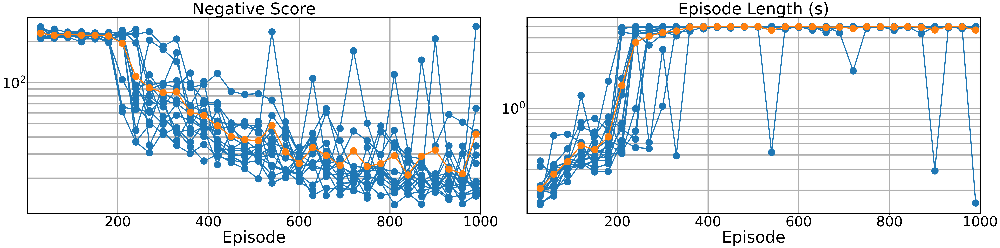

In [33]:
plot.plot_evaluation_histories(histories_DDQN, save_to_file='output_images/plot_evaluation_mean_ddqn')

### TD3

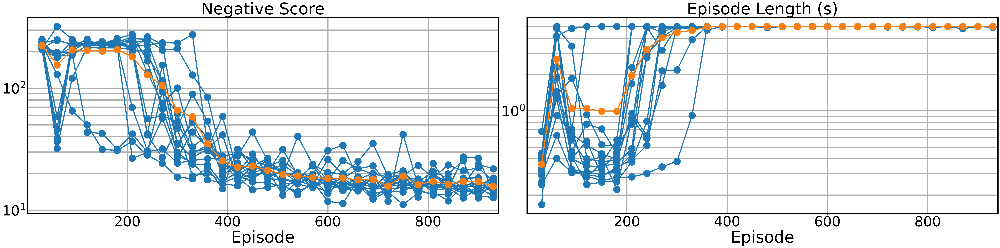

In [34]:
plot.plot_evaluation_histories(histories_TD3, save_to_file='output_images/plot_evaluation_mean_td3')

### Both

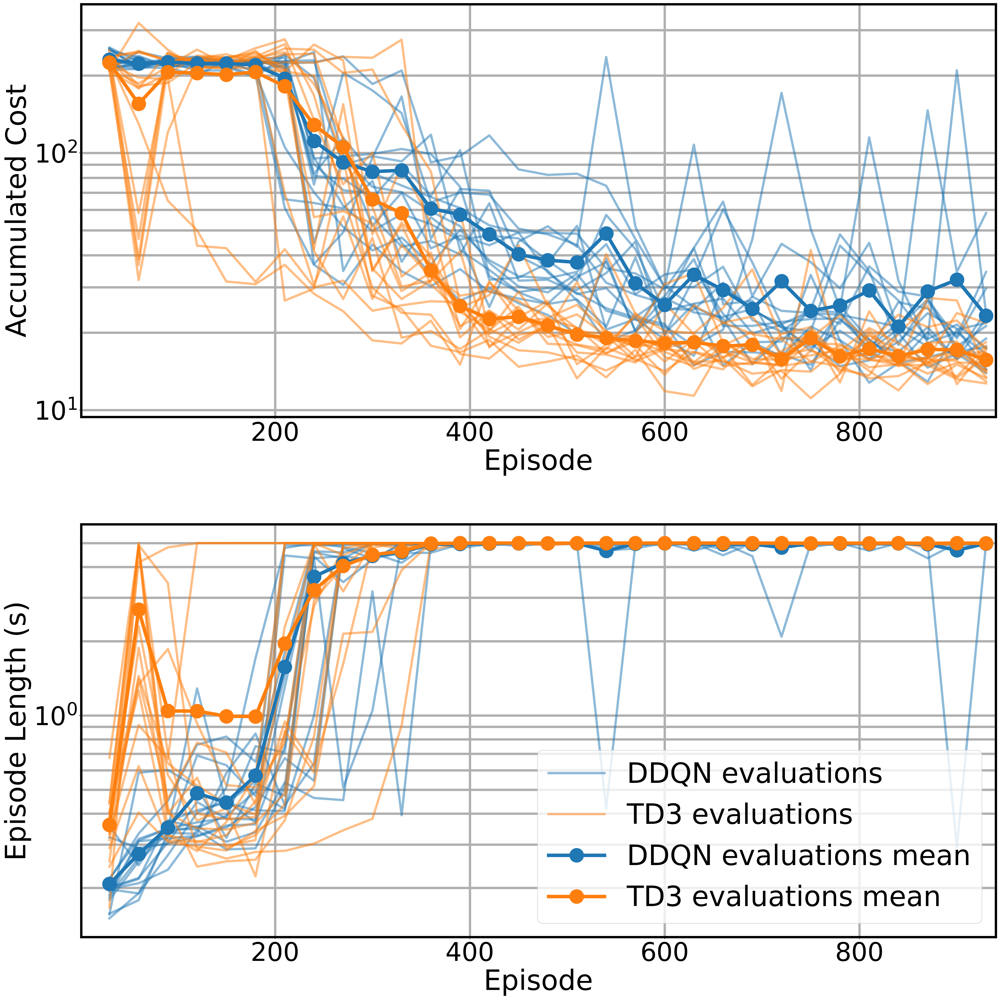

In [35]:
plot.plot_evaluation_histories_both(histories_DDQN, histories_TD3, transparency=0.5, save_to_file='output_images/plot_evaluation_mean_both')